## Label EDA

Image label EDA and visualising dataset images with singular labels to get an idea of ground truth.

In [2]:
import numpy as np
import pandas as pd

df = pd.read_csv('../input/train.csv')

In [3]:
# Transform string label to 19 one-hot columns
cols = [str(i) for i in list(range(19))]
df[cols] = np.nan

# Apply mapping
def encoder(row):
    labels = row['Label'].split('|')
    for label in labels:
        row[label] = 1    
    return row

df = df.apply(encoder, axis=1)
df.fillna(0, inplace=True)

In [4]:
# Column mapping for organelles
label_map = {
    '0': 'Nucleoplasm',
    '1': 'Nuclear membrane',
    '2': 'Nucleoli',
    '3': 'Nucleoli fibrillar center',
    '4': 'Nuclear speckles',
    '5': 'Nuclear bodies',
    '6': 'Endoplasmic reticulum',
    '7': 'Golgi apparatus',
    '8': 'Intermediate filaments',
    '9': 'Actin filaments',
    '10': 'Microtubules',
    
    '11': 'Mitotic spindle',
    '12': 'Centrosome',
    '13': 'Plasma membrane',
    '14': 'Mitochondria',
    '15': 'Aggresome',
    '16': 'Cytosol',
    '17': 'Vesicles and punctate cytosolic patterns',
    '18': 'Negative'
}

df.rename(columns=label_map, inplace=True)

### Occurence of Labels

In [5]:
labels = df.iloc[:, 2:]
labels.sum().sort_values()

Negative                                      34.0
Mitotic spindle                               78.0
Aggresome                                    252.0
Vesicles and punctate cytosolic patterns     593.0
Endoplasmic reticulum                        775.0
Microtubules                                 818.0
Intermediate filaments                       964.0
Actin filaments                              998.0
Nuclear membrane                            1095.0
Nucleoli fibrillar center                   1262.0
Nuclear speckles                            1425.0
Centrosome                                  1734.0
Nuclear bodies                              1792.0
Golgi apparatus                             1846.0
Mitochondria                                2013.0
Nucleoli                                    2451.0
Plasma membrane                             3111.0
Cytosol                                     5685.0
Nucleoplasm                                 8797.0
dtype: float64

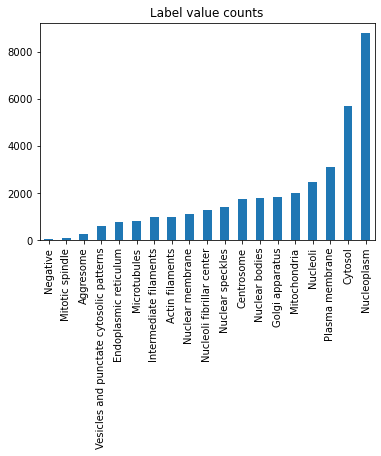

In [6]:
labels.sum().sort_values().plot(kind='bar', title='Label value counts');

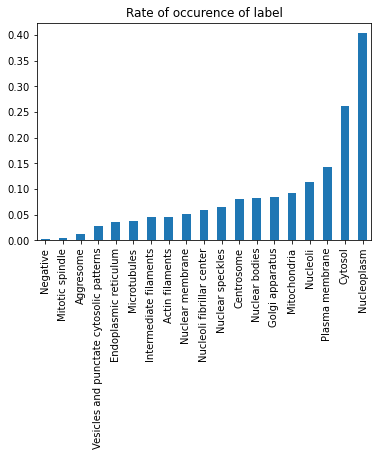

In [7]:
labels.mean().sort_values().plot(kind='bar', title='Rate of occurence of label');

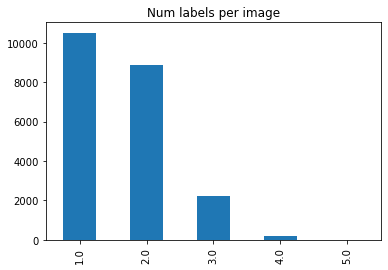

In [8]:
# Distribution of number of labels per image
labels.sum(axis=1).value_counts().plot(kind='bar', title='Num labels per image');

Correlation among labels is really low. No help here.

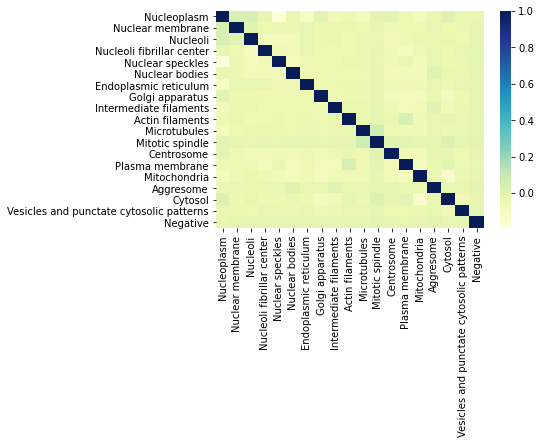

In [9]:
# Check for correlation among labels
from seaborn import heatmap
corr_table = labels.corr()
heatmap(corr_table, cmap="YlGnBu");

### An attempt at visualising rare classes...

1. Negative

(Why is negative labelled as present in some of the images, this is the placeholder class no??)

In [10]:
i_d = df[(df['Negative'] == 1) & (df.sum(axis=1) == 1)]['ID'].iloc[0]
print(i_d)

a34d8680-bb99-11e8-b2b9-ac1f6b6435d0


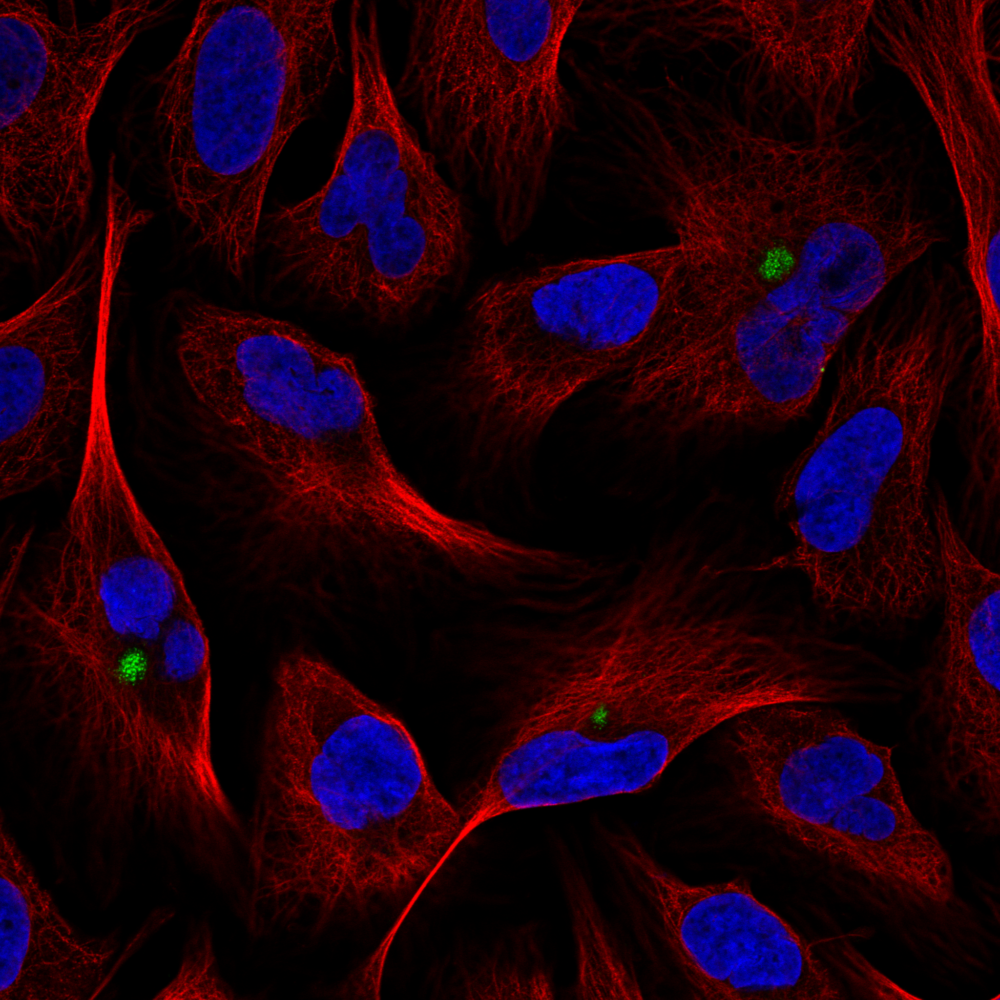

In [11]:
from PIL import Image
def show_image(i_d, path='../input/label_examples/'):
    red    = Image.open(path+i_d+'_red.png')
    green  = Image.open(path+i_d+'_green.png')
    blue   = Image.open(path+i_d+'_blue.png')
    yellow = Image.open(path+i_d+'_yellow.png')
    rgb = Image.merge("RGB", (red, green, blue))
    return rgb
    
show_image(i_d)

b6a469d8-bbad-11e8-b2ba-ac1f6b6435d0


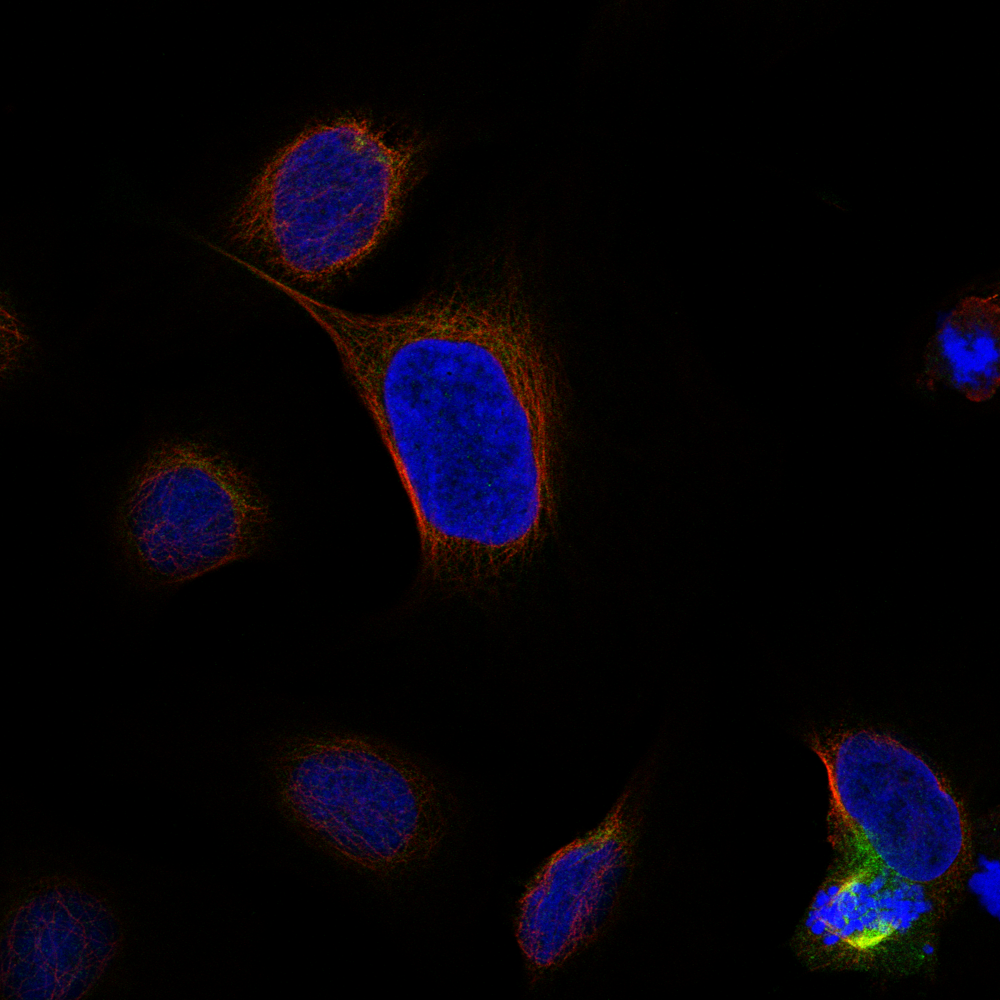

In [12]:
i_d = df[(df['Mitotic spindle'] == 1) & (df.sum(axis=1) == 1)]['ID'].iloc[0]
print(i_d)
show_image(i_d)

f0ac7116-bb99-11e8-b2b9-ac1f6b6435d0


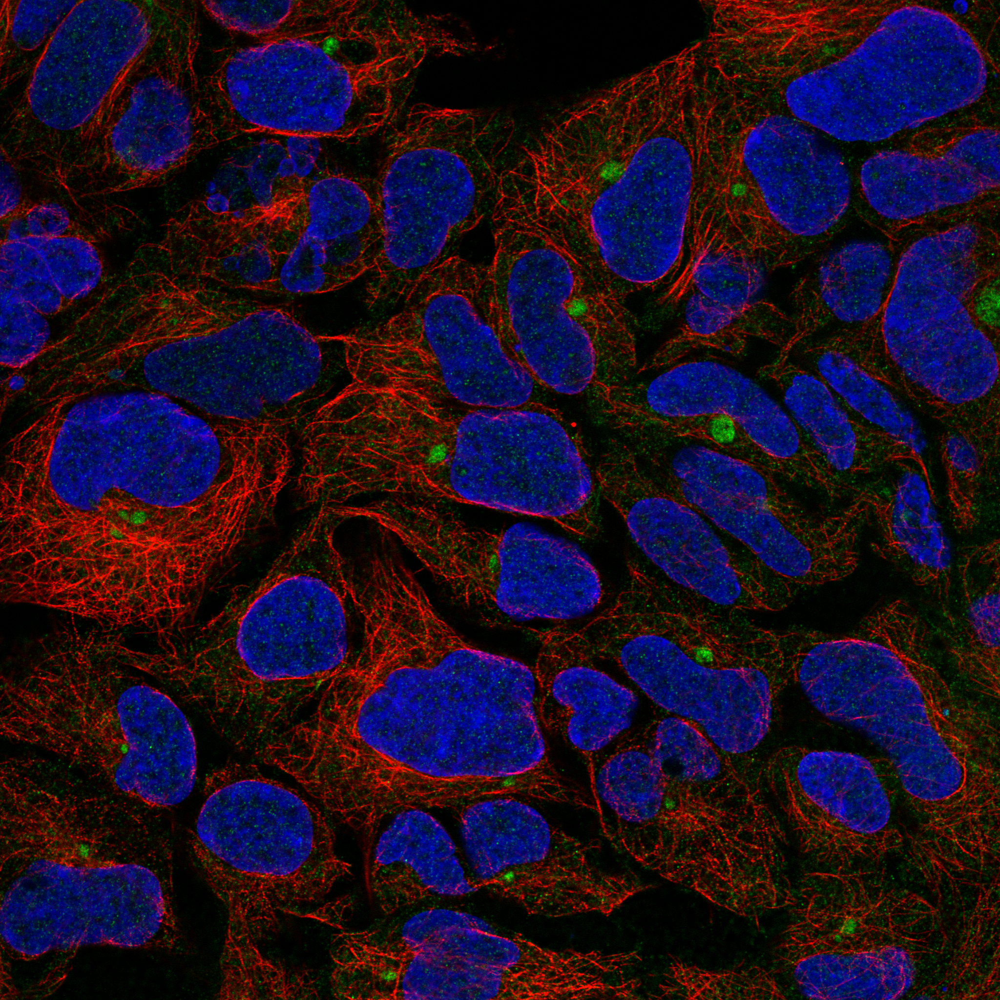

In [13]:
i_d = df[(df['Aggresome'] == 1) & (df.sum(axis=1) == 1)]['ID'].iloc[0]
print(i_d)
show_image(i_d)

a7faf0b4-bb99-11e8-b2b9-ac1f6b6435d0


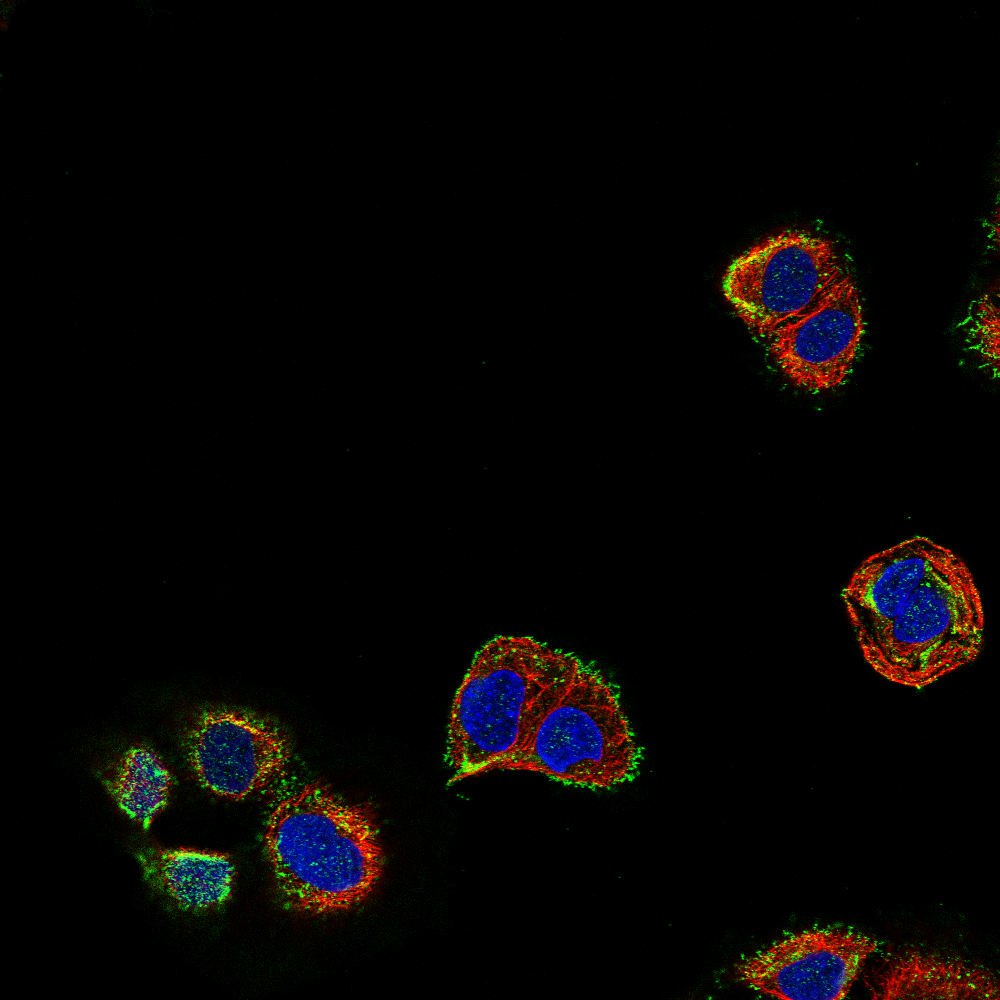

In [14]:
i_d = df[(df['Vesicles and punctate cytosolic patterns'] == 1) & (df.sum(axis=1) == 1)]['ID'].iloc[0]
print(i_d)
show_image(i_d)